<a href="https://colab.research.google.com/github/teegrun/colab/blob/main/M_1_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import glob
import os
import numpy as np
import warnings
import statistics
import datetime
import random
import seaborn as sns
color = sns.color_palette()
sns.set(rc={'figure.figsize':(25,15)})
import matplotlib.pyplot as plt
plt.style.use('ggplot')
from mpl_toolkits.axes_grid1 import make_axes_locatable
from keras.models import Sequential
from keras.layers import Dense
from keras.wrappers.scikit_learn import KerasRegressor
from keras.wrappers.scikit_learn import KerasClassifier
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import LabelEncoder
from keras.utils import np_utils
from string import ascii_letters




%matplotlib inline
import plotly
# connected=True means it will download the latest version of plotly javascript library.
plotly.offline.init_notebook_mode(connected=True)
import plotly.graph_objs as go
from plotly.offline import iplot
import plotly.figure_factory as ff
import plotly.express as px
import cufflinks as cf
import warnings
warnings.filterwarnings('ignore')
#import packages



In [ ]:
#from numpy.random import RandomState
rawdata = pd.read_csv('https://raw.githubusercontent.com/teegrun/colab/main/googleplaystore.csv')

df=rawdata.sample(frac=0.3,random_state=200) #random state is a seed value
test=rawdata.drop(df.index)

#input file

In [ ]:
print(test)

                                                     App  ...         Android Ver
0         Photo Editor & Candy Camera & Grid & ScrapBook  ...        4.0.3 and up
1                                    Coloring book moana  ...        4.0.3 and up
2      U Launcher Lite – FREE Live Cool Themes, Hide ...  ...        4.0.3 and up
3                                  Sketch - Draw & Paint  ...          4.2 and up
4                  Pixel Draw - Number Art Coloring Book  ...          4.4 and up
...                                                  ...  ...                 ...
10834                                      FR Calculator  ...          4.1 and up
10836                                   Sya9a Maroc - FR  ...          4.1 and up
10837                   Fr. Mike Schmitz Audio Teachings  ...          4.1 and up
10838                             Parkinson Exercices FR  ...          2.2 and up
10840      iHoroscope - 2018 Daily Horoscope & Astrology  ...  Varies with device

[7589 rows x 13

In [ ]:
def enable_plotly_in_cell():
  import IPython
  from plotly.offline import init_notebook_mode
  display(IPython.core.display.HTML('''<script src="/static/components/requirejs/require.js"></script>'''))
  init_notebook_mode(connected=False)
  #SEHR WICHTIG! steht für die Visualisierung

In [ ]:
print(df)
#show df

                                               App  ...         Android Ver
8968                       DV - Digito Verificador  ...          4.0 and up
4208             Alphabet "H" Passcode Lock Screen  ...          4.1 and up
384                  Hangouts Dialer - Call Phones  ...        4.0.3 and up
4243                                       NinJump  ...          4.1 and up
179                                   Moon+ Reader  ...  Varies with device
...                                            ...  ...                 ...
473                   Talkray - Free Calls & Texts  ...  Varies with device
5242   Bonza Poly Art - Tenkyu Animal Jam for Kids  ...          4.1 and up
731                English words application mikan  ...          4.1 and up
10719                    Sona - Nær við allastaðni  ...          4.4 and up
392                                       Telegram  ...  Varies with device

[3252 rows x 13 columns]


In [ ]:
df.head()
#display data via pandas data.head

,App,Category,Rating,Reviews,Size,Installs,Type,Price,Content Rating,Genres,Last Updated,Current Ver,Android Ver
8968,DV - Digito Verificador,TOOLS,NaN,2,4.2M,500+,Free,0,Everyone,Tools,"March 2, 2017",1.0,4.0 and up
4208,"Alphabet ""H"" Passcode Lock Screen",PERSONALIZATION,4.5,2,3.0M,100+,Free,0,Everyone,Personalization,"December 21, 2017",1.0,4.1 and up
384,Hangouts Dialer - Call Phones,COMMUNICATION,4.0,122498,79k,"10,000,000+",Free,0,Everyone,Communication,"September 2, 2015",0.1.100944346,4.0.3 and up
4243,NinJump,GAME,4.3,421000,36M,"10,000,000+",Free,0,Everyone,Arcade,"June 13, 2018",3.1.1,4.1 and up
179,Moon+ Reader,BOOKS_AND_REFERENCE,4.4,233757,Varies with device,"10,000,000+",Free,0,Everyone,Books & Reference,"May 1, 2018",Varies with device,Varies with device


In [ ]:
df.info()
#show info about data

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3252 entries, 8968 to 392
Data columns (total 13 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   App             3252 non-null   object 
 1   Category        3252 non-null   object 
 2   Rating          2795 non-null   float64
 3   Reviews         3252 non-null   object 
 4   Size            3252 non-null   object 
 5   Installs        3252 non-null   object 
 6   Type            3252 non-null   object 
 7   Price           3252 non-null   object 
 8   Content Rating  3251 non-null   object 
 9   Genres          3252 non-null   object 
 10  Last Updated    3252 non-null   object 
 11  Current Ver     3250 non-null   object 
 12  Android Ver     3250 non-null   object 
dtypes: float64(1), object(12)
memory usage: 355.7+ KB


In [ ]:
df.shape
#show shape of data

(3252, 13)

In [ ]:
df['App'].nunique()
#show unique values in data

3113

In [ ]:
df.App.duplicated()
#show duplicated data in column 'App'

8968     False
4208     False
384      False
4243     False
179      False
         ...  
473      False
5242     False
731      False
10719    False
392       True
Name: App, Length: 3252, dtype: bool

In [ ]:
df.App.duplicated().sum()
#show the sum of dup. data

139

In [ ]:
#df = cleaned_data.drop(cleaned_data.
                               #columns[[2,3,9,10,12]],
                            #axis = 1)     

In [ ]:
df.head()

,App,Category,Rating,Reviews,Size,Installs,Type,Price,Content Rating,Genres,Last Updated,Current Ver,Android Ver
8968,DV - Digito Verificador,TOOLS,NaN,2,4.2M,500+,Free,0,Everyone,Tools,"March 2, 2017",1.0,4.0 and up
4208,"Alphabet ""H"" Passcode Lock Screen",PERSONALIZATION,4.5,2,3.0M,100+,Free,0,Everyone,Personalization,"December 21, 2017",1.0,4.1 and up
384,Hangouts Dialer - Call Phones,COMMUNICATION,4.0,122498,79k,"10,000,000+",Free,0,Everyone,Communication,"September 2, 2015",0.1.100944346,4.0.3 and up
4243,NinJump,GAME,4.3,421000,36M,"10,000,000+",Free,0,Everyone,Arcade,"June 13, 2018",3.1.1,4.1 and up
179,Moon+ Reader,BOOKS_AND_REFERENCE,4.4,233757,Varies with device,"10,000,000+",Free,0,Everyone,Books & Reference,"May 1, 2018",Varies with device,Varies with device


In [ ]:
df['Current Ver'].nunique()



1250

In [ ]:
#df.drop(df.index[df['Current Ver'] == 'Varies with device'], inplace = True)
result = df.select_dtypes(include='number')
print(result)

       Rating
8968      NaN
4208      4.5
384       4.0
4243      4.3
179       4.4
...       ...
473       4.2
5242      4.1
731       4.7
10719     4.2
392       4.4

[3252 rows x 1 columns]


In [ ]:
# display lenght of the name
df['Name Lenght'] = df['App'].apply(len)

display(df)

,App,Category,Rating,Reviews,Size,Installs,Type,Price,Content Rating,Genres,Last Updated,Current Ver,Android Ver,Name Lenght
8968,DV - Digito Verificador,TOOLS,NaN,2,4.2M,500+,Free,0,Everyone,Tools,"March 2, 2017",1.0,4.0 and up,23
4208,"Alphabet ""H"" Passcode Lock Screen",PERSONALIZATION,4.5,2,3.0M,100+,Free,0,Everyone,Personalization,"December 21, 2017",1.0,4.1 and up,33
384,Hangouts Dialer - Call Phones,COMMUNICATION,4.0,122498,79k,"10,000,000+",Free,0,Everyone,Communication,"September 2, 2015",0.1.100944346,4.0.3 and up,29
4243,NinJump,GAME,4.3,421000,36M,"10,000,000+",Free,0,Everyone,Arcade,"June 13, 2018",3.1.1,4.1 and up,7
179,Moon+ Reader,BOOKS_AND_REFERENCE,4.4,233757,Varies with device,"10,000,000+",Free,0,Everyone,Books & Reference,"May 1, 2018",Varies with device,Varies with device,12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
473,Talkray - Free Calls & Texts,COMMUNICATION,4.2,244863,Varies with device,"10,000,000+",Free,0,Everyone,Communication,"May 29, 2018",Varies with device,Varies with device,28
5242,Bonza Poly Art - Tenkyu Animal Jam for Kids,FAMILY,4.1,22,31M,"1,000+",Free,0,Everyone,Puzzle,"August 3, 2018",1.0.9,4.1 and up,43
731,English words application mikan,EDUCATION,4.7,9888,Varies with device,"500,000+",Free,0,Everyone,Education,"July 30, 2018",Varies with device,4.1 and up,31
10719,Sona - Nær við allastaðni,LIFESTYLE,4.2,31,25M,"1,000+",Free,0,Everyone,Lifestyle,"August 2, 2018",1.6.3,4.4 and up,25


In [ ]:
#pd.read_csv('final_data.csv')
#df_corr = df.corr()

#print(data.corr())
  
#dataplot = sns.heatmap(data.corr(), cmap="YlGnBu", annot=True)
  
# displaying heatmap
#plt.show()


In [ ]:
#print(type(df['Installs'].values))

In [ ]:
df['Category'].nunique()
#wie viele Uniques? MUSS 33 sein

34

In [ ]:
df.Category.unique()
#k.A. warum aber beim final_data zeigt es 1.9 als Category

array(['TOOLS', 'PERSONALIZATION', 'COMMUNICATION', 'GAME',
       'BOOKS_AND_REFERENCE', 'TRAVEL_AND_LOCAL', 'PRODUCTIVITY',
       'SHOPPING', 'SOCIAL', 'HEALTH_AND_FITNESS', 'FAMILY', 'DATING',
       'MEDICAL', 'SPORTS', 'LIFESTYLE', 'ENTERTAINMENT', 'WEATHER',
       'EVENTS', 'PARENTING', 'NEWS_AND_MAGAZINES', 'MAPS_AND_NAVIGATION',
       'BUSINESS', 'FOOD_AND_DRINK', 'VIDEO_PLAYERS', 'FINANCE',
       'ART_AND_DESIGN', 'EDUCATION', 'LIBRARIES_AND_DEMO',
       'AUTO_AND_VEHICLES', 'PHOTOGRAPHY', 'BEAUTY', 'COMICS',
       'HOUSE_AND_HOME', '1.9'], dtype=object)

In [ ]:
#print(final_data.dtypes)
#final_data.loc[final_data.App=='Tiny Scanner - PDF Scanner App']
#final_data[final_data.duplicated(keep='first')]
df.drop_duplicates(subset='App', inplace=True)
#final_data.drop bereinigt schon, also man braucht keine Bereinigung vorher
df = df[df['Android Ver'] != np.nan]
df = df[df['Android Ver'] != 'NaN']
df = df[df['Installs'] != 'Free']
df = df[df['Installs'] != 'Paid']

df['Installs'] = df['Installs'].apply(lambda x: x.replace('+', '') if '+' in str(x) else x)
df['Installs'] = df['Installs'].apply(lambda x: x.replace(',', '') if ',' in str(x) else x)
df['Installs'] = df['Installs'].apply(lambda x: int(x))

df['Size'] = df['Size'].apply(lambda x: str(x).replace('Varies with device', 'NaN') if 'Varies with device' in str(x) else x)

df['Size'] = df['Size'].apply(lambda x: str(x).replace('M', '') if 'M' in str(x) else x)
df['Size'] = df['Size'].apply(lambda x: str(x).replace(',', '') if 'M' in str(x) else x)
df['Size'] = df['Size'].apply(lambda x: float(str(x).replace('k', '')) / 1000 if 'k' in str(x) else x)


df['Size'] = df['Size'].apply(lambda x: float(x))
df['Installs'] = df['Installs'].apply(lambda x: float(x))

df['Price'] = df['Price'].apply(lambda x: str(x).replace('$', '') if '$' in str(x) else str(x))
df['Price'] = df['Price'].apply(lambda x: float(x))

df['Reviews'] = df['Reviews'].apply(lambda x: int(x))




# x = data['Rating'].dropna()
# y = data['Size'].dropna()
# z = data['Installs'][data.Installs!=0].dropna()
# p = data['Reviews'][data.Reviews!=0].dropna()
# t = data['Type'].dropna()
# price = data['Price']

# p = sns.pairplot(pd.DataFrame(list(zip(x, y, np.log(z), np.log10(p), t, price)), 
#                                           #columns=['Rating','Size', 'Installs', 'Reviews', 'Type', 'Price']), hue='Type', palette="Set2")

In [ ]:
#kürzt die Tabelle ab, lässt die "unnötigen" Spalten weg
#newdf = df.drop(df.
                               #columns[[2,3,9,10,12]],
                            #axis = 1)     

In [ ]:
df['App'].nunique()


3112

In [ ]:
df.App.duplicated().sum()


0

In [ ]:
print(df)

                                               App  ... Name Lenght
8968                       DV - Digito Verificador  ...          23
4208             Alphabet "H" Passcode Lock Screen  ...          33
384                  Hangouts Dialer - Call Phones  ...          29
4243                                       NinJump  ...           7
179                                   Moon+ Reader  ...          12
...                                            ...  ...         ...
6351                       Metal Detector Pro 2015  ...          23
473                   Talkray - Free Calls & Texts  ...          28
5242   Bonza Poly Art - Tenkyu Animal Jam for Kids  ...          43
731                English words application mikan  ...          31
10719                    Sona - Nær við allastaðni  ...          25

[3112 rows x 14 columns]


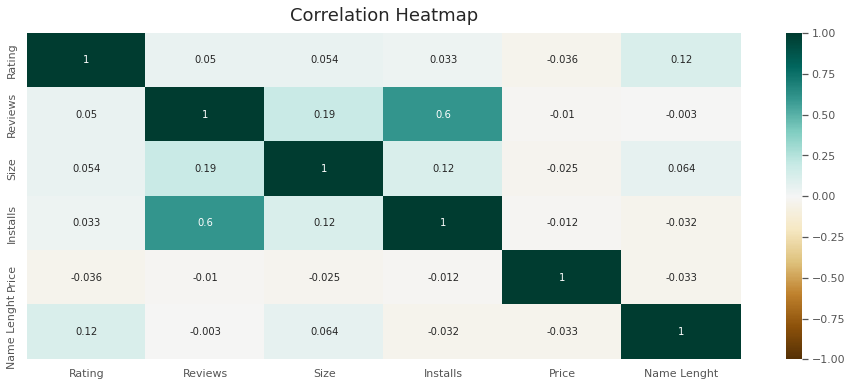

In [ ]:
#corrmat = df.corr()
#f, ax = plt.subplots()
#p =sns.heatmap(corrmat, annot=True, cmap=sns.diverging_palette(220, 20, as_cmap=True))
#oben: version #1

plt.figure(figsize=(16, 6))
heatmap = sns.heatmap(df.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap', fontdict={'fontsize':18}, pad=12);
#oben: version #2

In [ ]:
#df['Category']. astype(str)
#obsolet, muss vor dem großen Stück K stehen

In [ ]:
df['Category'].nunique()
#nur top 10 Genres nehmen, da 34 zu viel für nen Heatmap???

33

In [ ]:
number_of_apps_in_category = final_data['Category'].value_counts().sort_values(ascending=True)
##wenn 1.9 als Category --> df als Input nutzen
#from plotly.offline import iplot
#import plotly.graph_objs as go

enable_plotly_in_cell()
#die drei (doch 1) oben sind wichtig für Visualisierung (sh.am Anfang)
data = [go.Pie(
        labels = number_of_apps_in_category.index,
        values = number_of_apps_in_category.values,
        hoverinfo = 'label+value'
    
)]

plotly.offline.iplot(data, filename = number_of_apps_in_category)

In [ ]:
number_of_apps_in_category = df['Category'].value_counts().sort_values(ascending=True)


enable_plotly_in_cell()

data = [go.Bar(
        x = number_of_apps_in_category.index,
        y = number_of_apps_in_category.values,
        

    
)]

plotly.offline.iplot(data, filename = number_of_apps_in_category)

In [ ]:
installs_per_category = df.groupby('Category')[['Installs']].sum()
installs_per_category.apply(lambda x: '%.f' % x, axis=1)
#installs_per_category.info()
#lambda gegen exp. Zahlen

Category
ART_AND_DESIGN           35180000
AUTO_AND_VEHICLES        11182585
BEAUTY                    5296100
BOOKS_AND_REFERENCE    1306870270
BUSINESS                212961002
COMICS                   20055150
COMMUNICATION          8437120185
DATING                   82647791
EDUCATION               236550000
ENTERTAINMENT           668300000
EVENTS                    3432811
FAMILY                 2696146277
FINANCE                 220836571
FOOD_AND_DRINK           50780266
GAME                   7419999751
HEALTH_AND_FITNESS      410031325
HOUSE_AND_HOME           39815050
LIBRARIES_AND_DEMO       13029010
LIFESTYLE               205421156
MAPS_AND_NAVIGATION     172514120
MEDICAL                  15376608
NEWS_AND_MAGAZINES     1646335140
PARENTING                10450100
PERSONALIZATION         902445388
PHOTOGRAPHY            2128697575
PRODUCTIVITY           2562559756
SHOPPING                746077450
SOCIAL                 4713069717
SPORTS                  329035826
TOOLS

In [ ]:
#installs_per_cat = installs_per_category['Installs'].value_counts().sort_values(ascending=True)


number_of_apps_in_category = df['Category'].value_counts().sort_values(ascending=True)


enable_plotly_in_cell()

data = [go.Bar(
        
        x = number_of_apps_in_category.index. sort_values (ascending=True),
        y = installs_per_category['Installs'],
      
      
        
    
)]
plotly.offline.iplot(data, filename = installs_per_category)

In [ ]:
 mean_per_category = df.groupby('Category')['Installs'].mean()
 mean_per_category.apply(lambda x: '%.f' % x)

Category
ART_AND_DESIGN          1759000
AUTO_AND_VEHICLES        447303
BEAUTY                   331006
BOOKS_AND_REFERENCE    18150976
BUSINESS                1760008
COMICS                   955007
COMMUNICATION          79595473
DATING                  1215409
EDUCATION               6570833
ENTERTAINMENT          16707500
EVENTS                   171641
FAMILY                  4680810
FINANCE                 2400398
FOOD_AND_DRINK          1538796
GAME                   22484848
HEALTH_AND_FITNESS      3761755
HOUSE_AND_HOME          1990752
LIBRARIES_AND_DEMO       542875
LIFESTYLE               1697696
MAPS_AND_NAVIGATION     4312853
MEDICAL                  109833
NEWS_AND_MAGAZINES     19835363
PARENTING                475005
PERSONALIZATION         7336954
PHOTOGRAPHY            22173933
PRODUCTIVITY           21716608
SHOPPING               10362187
SOCIAL                 69309849
SPORTS                  3104112
TOOLS                  14296130
TRAVEL_AND_LOCAL       32054758

In [ ]:
enable_plotly_in_cell()


data = [go.Bar(
        x = number_of_apps_in_category.index. sort_values (ascending=True),
      
        y = df.groupby('Category')['Installs'].mean()
        
    
)]

plotly.offline.iplot(data, filename = mean_per_category)

In [ ]:
enable_plotly_in_cell()


data = [go.Bar(
        x = number_of_apps_in_category.index. sort_values (ascending=True),
      
        y = df.groupby('Category')['Installs'].mean()
        
    
)]

plotly.offline.iplot(data, filename = mean_per_category)

In [ ]:
# median_per_category = df.groupby('Category')['Installs'].median()
# median_per_category.apply(lambda x: '%.f' % x)
 #komisch!?

In [ ]:
mean_price_per_category = df.groupby('Category')['Price'].mean()
mean_price_per_category.apply(lambda x: '%.2f' % x)
#durch. preis per Kategorie, vllt median besser?

Category
ART_AND_DESIGN          0.10
AUTO_AND_VEHICLES       0.40
BEAUTY                  0.00
BOOKS_AND_REFERENCE     0.38
BUSINESS                0.08
COMICS                  0.00
COMMUNICATION           0.38
DATING                  0.12
EDUCATION               0.00
ENTERTAINMENT           0.00
EVENTS                  5.50
FAMILY                  1.77
FINANCE                21.99
FOOD_AND_DRINK          0.00
GAME                    0.28
HEALTH_AND_FITNESS      0.28
HOUSE_AND_HOME          0.00
LIBRARIES_AND_DEMO      0.00
LIFESTYLE               9.90
MAPS_AND_NAVIGATION     0.05
MEDICAL                 3.77
NEWS_AND_MAGAZINES      0.00
PARENTING               0.21
PERSONALIZATION         0.54
PHOTOGRAPHY             0.21
PRODUCTIVITY            0.22
SHOPPING                0.08
SOCIAL                  0.00
SPORTS                  0.34
TOOLS                   0.27
TRAVEL_AND_LOCAL        0.12
VIDEO_PLAYERS           0.15
WEATHER                 0.28
Name: Price, dtype: object

In [ ]:
enable_plotly_in_cell()


data = [go.Bar(
        x = number_of_apps_in_category.index. sort_values (ascending=True),
      
        y = df.groupby('Category')['Price'].mean()
        
    
)]

plotly.offline.iplot(data, filename = mean_price_per_category)

In [ ]:
max_price_per_category = df.groupby('Category')['Price'].max()
max_price_per_category.apply(lambda x: '%.2f' % x)
 #höchste Preise per Kategorie, um die Ausreißer zu identifizieren

Category
ART_AND_DESIGN           1.99
AUTO_AND_VEHICLES        9.99
BEAUTY                   0.00
BOOKS_AND_REFERENCE      5.99
BUSINESS                 4.99
COMICS                   0.00
COMMUNICATION           19.99
DATING                   7.99
EDUCATION                0.00
ENTERTAINMENT            0.00
EVENTS                 109.99
FAMILY                 399.99
FINANCE                399.99
FOOD_AND_DRINK           0.00
GAME                    17.99
HEALTH_AND_FITNESS       9.99
HOUSE_AND_HOME           0.00
LIBRARIES_AND_DEMO       0.00
LIFESTYLE              399.99
MAPS_AND_NAVIGATION      0.99
MEDICAL                200.00
NEWS_AND_MAGAZINES       0.00
PARENTING                4.59
PERSONALIZATION          9.99
PHOTOGRAPHY              5.99
PRODUCTIVITY             5.99
SHOPPING                 2.99
SOCIAL                   0.00
SPORTS                  29.99
TOOLS                    8.99
TRAVEL_AND_LOCAL         4.99
VIDEO_PLAYERS            5.99
WEATHER                  2.99
N

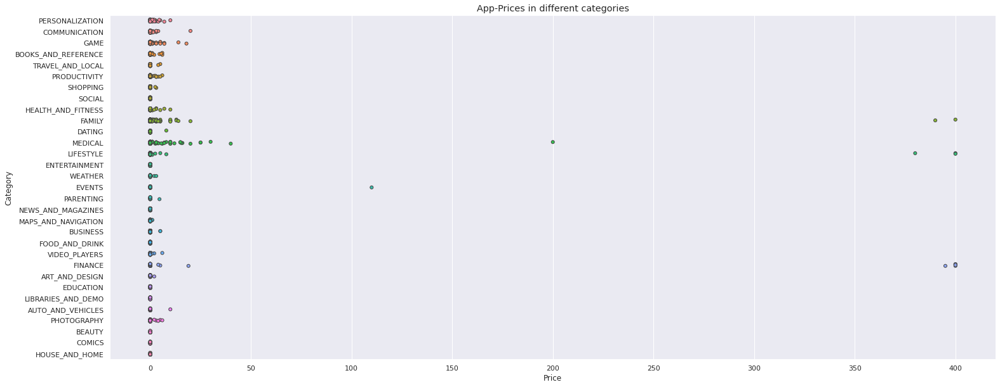

In [ ]:
subset_df = df[df.Category.isin(['ART_AND_DESIGN', 'AUTO_AND_VEHICLES', 'BEAUTY', 'BOOKS_AND_REFERENCE' , 'BUSINESS', 
                                 'COMICS', 'COMMUNICATION', 'DATING', 'EDUCATION', 'ENTERTAINMENT', 'EVENTS', 'FAMILY', 
                                 'FINANCE', 'FOOD_AND_DRINK', 'GAME', 'HEALTH_AND_FITNESS', 'HOUSE_AND_HOME', 
                                 'LIBRARIES_AND_DEMO', 'LIFESTYLE', 'MAPS_AND_NAVIGATION', 'MEDICAL', 'NEWS_AND_MAGAZINES', 
                                 'PARENTING', 'PERSONALIZATION', 'PHOTOGRAPHY','PRODUCTIVITY', 'SHOPPING', 'SOCIAL', 'SPORTS'
                                  'TOOLS', 'TRAVEL_AND_LOCAL','VIDEO_PLAYERS', 'WEATHER'])]
sns.set_style('darkgrid')
fig, ax = plt.subplots()
fig.set_size_inches(25, 10)
p = sns.stripplot(x="Price", y="Category", data=subset_df, jitter=True, linewidth=1)
title = ax.set_title('App-Prices in different categories')


In [ ]:
mean_rating_per_category = df.groupby('Category')['Rating'].mean()
mean_rating_per_category.apply(lambda x: '%.2f' % x)

Category
ART_AND_DESIGN         4.43
AUTO_AND_VEHICLES      4.31
BEAUTY                 4.20
BOOKS_AND_REFERENCE    4.32
BUSINESS               4.14
COMICS                 4.06
COMMUNICATION          4.14
DATING                 4.03
EDUCATION              4.36
ENTERTAINMENT          4.07
EVENTS                 4.48
FAMILY                 4.23
FINANCE                4.14
FOOD_AND_DRINK         4.03
GAME                   4.27
HEALTH_AND_FITNESS     4.37
HOUSE_AND_HOME         4.20
LIBRARIES_AND_DEMO     4.27
LIFESTYLE              4.10
MAPS_AND_NAVIGATION    4.07
MEDICAL                4.24
NEWS_AND_MAGAZINES     4.17
PARENTING              4.29
PERSONALIZATION        4.34
PHOTOGRAPHY            4.22
PRODUCTIVITY           4.18
SHOPPING               4.29
SOCIAL                 4.29
SPORTS                 4.25
TOOLS                  4.09
TRAVEL_AND_LOCAL       4.11
VIDEO_PLAYERS          4.01
WEATHER                4.29
Name: Rating, dtype: object

In [ ]:
enable_plotly_in_cell()


data = [go.Bar(
        x = number_of_apps_in_category.index. sort_values (ascending=True),
      
        y = df.groupby('Category')['Rating'].mean()
        
    
)]

plotly.offline.iplot(data, filename = mean_rating_per_category)

In [ ]:
cat_ART_AND_DESIGN = df[(df.Category == 'ART_AND_DESIGN')]
cat_AUTO_AND_VEHICLES = df[(df.Category == 'AUTO_AND_VEHICLES')]
cat_BEAUTY = df[(df.Category == 'BEAUTY')]
cat_BOOKS_AND_REFERENCE = df[(df.Category == 'BOOKS_AND_REFERENCE')]
cat_BUSINESS = df[(df.Category == 'BUSINESS')]
cat_COMICS = df[(df.Category == 'COMICS')]
cat_COMMUNICATION = df[(df.Category == 'COMMUNICATION')]
cat_DATING = df[(df.Category == 'DATING')]
cat_EDUCATION = df[(df.Category == 'EDUCATION')]
cat_ENTERTAINMENT = df[(df.Category == 'ENTERTAINMENT')]
cat_EVENTS = df[(df.Category == 'EVENTS')]
cat_FAMILY = df[(df.Category == 'FAMILY')]
cat_FINANCE = df[(df.Category == 'FINANCE')]
cat_FOOD_AND_DRINK = df[(df.Category == 'FOOD_AND_DRINK')]
cat_GAME = df[(df.Category == 'GAME')]
cat_HEALTH_AND_FITNESS = df[(df.Category == 'HEALTH_AND_FITNESS')]
cat_HOUSE_AND_HOME = df[(df.Category == 'HOUSE_AND_HOME')]
cat_LIBRARIES_AND_DEMO = df[(df.Category == 'LIBRARIES_AND_DEMO')]
cat_LIFESTYLE = df[(df.Category == 'LIFESTYLE')]
cat_MAPS_AND_NAVIGATION = df[(df.Category == 'MAPS_AND_NAVIGATION')]
cat_MEDICAL = df[(df.Category == 'MEDICAL')]
cat_NEWS_AND_MAGAZINES = df[(df.Category == 'NEWS_AND_MAGAZINES')]
cat_PARENTING = df[(df.Category == 'PARENTING')]
cat_PERSONALIZATION = df[(df.Category == 'PERSONALIZATION')]
cat_PHOTOGRAPHY = df[(df.Category == 'PHOTOGRAPHY')]
cat_PRODUCTIVITY = df[(df.Category == 'PRODUCTIVITY')]
cat_SHOPPING = df[(df.Category == 'SHOPPING')]
cat_SOCIAL = df[(df.Category == 'SOCIAL')]
cat_SPORTS = df[(df.Category == 'SPORTS')]
cat_TOOLS = df[(df.Category == 'TOOLS')]
cat_TRAVEL_AND_LOCAL = df[(df.Category == 'TRAVEL_AND_LOCAL')]
cat_VIDEO_PLAYERS = df[(df.Category == 'VIDEO_PLAYERS')]
cat_WEATHER = df[(df.Category == 'WEATHER')]

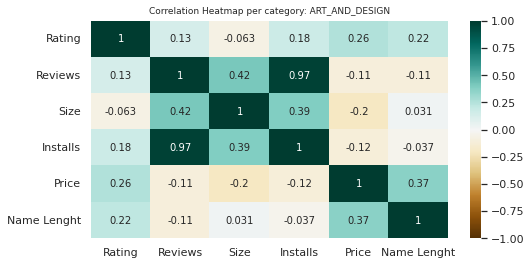

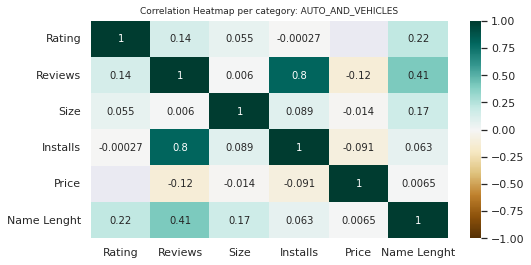

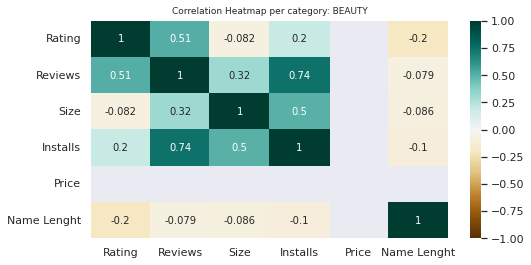

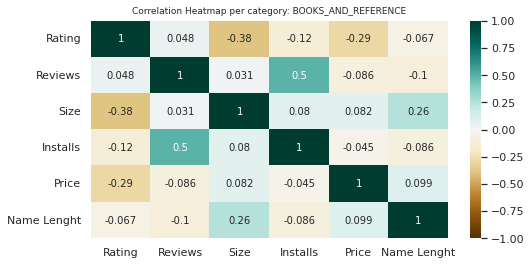

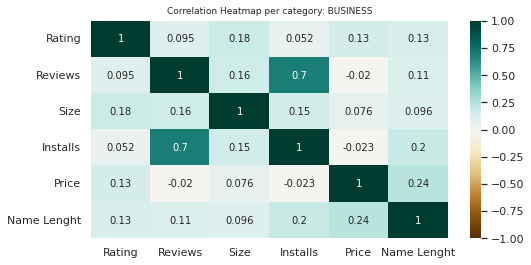

...

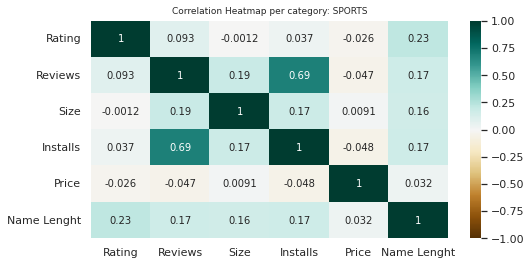

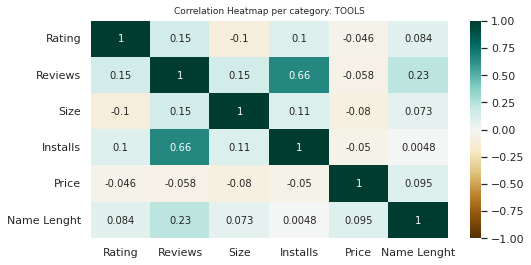

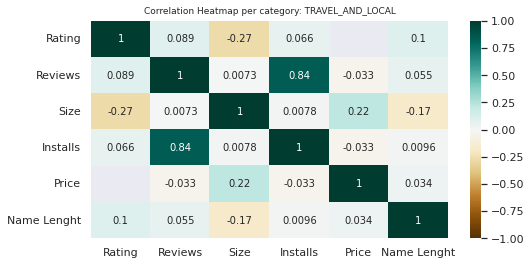

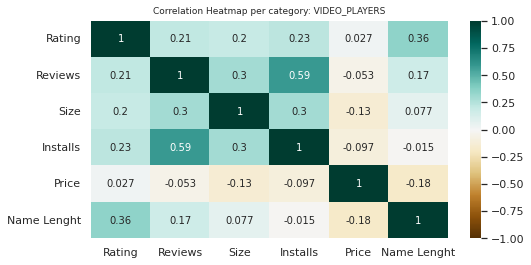

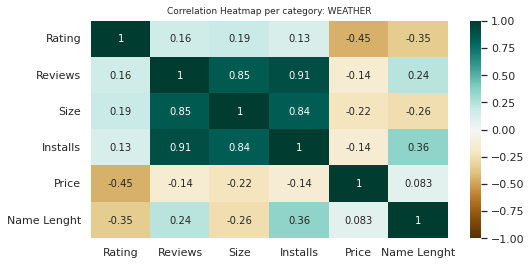

In [ ]:
plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_ART_AND_DESIGN.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: ART_AND_DESIGN', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_AUTO_AND_VEHICLES.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: AUTO_AND_VEHICLES', fontdict={'fontsize':9}, pad=7);
#fig, ((ax1), (ax2)) = plt.subplots(nrows=1, ncols=1)

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_BEAUTY.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: BEAUTY', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_BOOKS_AND_REFERENCE.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: BOOKS_AND_REFERENCE', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_BUSINESS.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: BUSINESS', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_COMICS.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: COMICS', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_COMMUNICATION.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: COMMUNICATION', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_DATING.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: DATING', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_EDUCATION.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: EDUCATION', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_ENTERTAINMENT.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: ENTERTAINMENT', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_EVENTS.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: EVENTS', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_FAMILY.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: FAMILY', fontdict={'fontsize':9}, pad=7);


plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_FINANCE.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: FINANCE', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_FOOD_AND_DRINK.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: FOOD_AND_DRINK', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_GAME.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: GAME', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_HEALTH_AND_FITNESS.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: HEALTH_AND_FITNESS', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_HOUSE_AND_HOME.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: HOUSE_AND_HOME', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_LIBRARIES_AND_DEMO.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: LIBRARIES_AND_DEMO', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_LIFESTYLE.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: LIFESTYLE', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_MAPS_AND_NAVIGATION.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: MAPS_AND_NAVIGATION', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_MEDICAL.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: MEDICAL', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_NEWS_AND_MAGAZINES.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: NEWS_AND_MAGAZINES', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_PARENTING.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: PARENTING', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_PERSONALIZATION.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: PERSONALIZATION', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_PHOTOGRAPHY.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: PHOTOGRAPHY', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_PRODUCTIVITY.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: PRODUCTIVITY', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_SHOPPING.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: SHOPPING', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_SOCIAL.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: SOCIAL', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_SPORTS.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: SPORTS', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_TOOLS.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: TOOLS', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_TRAVEL_AND_LOCAL.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: TRAVEL_AND_LOCAL', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_VIDEO_PLAYERS.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: VIDEO_PLAYERS', fontdict={'fontsize':9}, pad=7);

plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_WEATHER.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: WEATHER', fontdict={'fontsize':9}, pad=7);



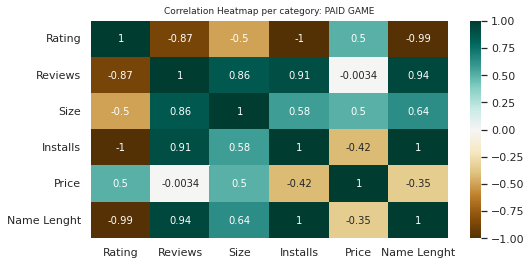

In [ ]:
cat_GAME = df[(df.Category == 'GAME')]
#cat_PAIDGAME = df[(df.Category == 'GAME') & (df.Type == 'Paid')]
cat_PAIDGAME_BIG = df[(df.Category == 'GAME') & (df.Size > 50) & (df.Type == 'Paid')]
#cat_PAIDGAME_BIG = df[(df.Category == 'GAME') & (df.Size > 75)]
#print(cat_PAIDGAME)
plt.figure(figsize=(8, 4))
heatmap = sns.heatmap(cat_PAIDGAME_BIG.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap per category: PAID GAME', fontdict={'fontsize':9}, pad=7);

In [ ]:
model_data = cat_PAIDGAME_BIG
print(cat_PAIDGAME_BIG)

                                                    App  ... Name Lenght
5641                        Five Nights at Freddy's: SL  ...          27
5557                             Nightenfell: Shared AR  ...          22
9165  League of Stickman 2018- Ninja Arena PVP(Dream...  ...          50

[3 rows x 14 columns]


In [ ]:
from sklearn.naive_bayes import GaussianNB
from sklearn.linear_model import SGDClassifier, LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from xgboost import XGBClassifier, XGBRFClassifier
from sklearn.metrics import confusion_matrix, accuracy_score, roc_auc_score, roc_curve
from sklearn import preprocessing
from sklearn.model_selection import train_test_split

In [ ]:
model_data = cat_PAIDGAME_BIG

In [ ]:
y1 = model_data['Price']
cols = [col for col in model_data.columns if col not in ['Price']]
X1 = model_data[cols]


In [ ]:
A= model_data['Price'].values.reshape(-1,1)
B= model_data['Installs']
from sklearn.linear_model import LinearRegression
model = LinearRegression()
model.fit(A,B)
model.coef_

array([-200250.])

In [ ]:
print("R Score: {:.2f}".format(model.score(A, B)))

R Score: 0.18


In [ ]:
model.intercept_

698747.5

<function matplotlib.pyplot.show>

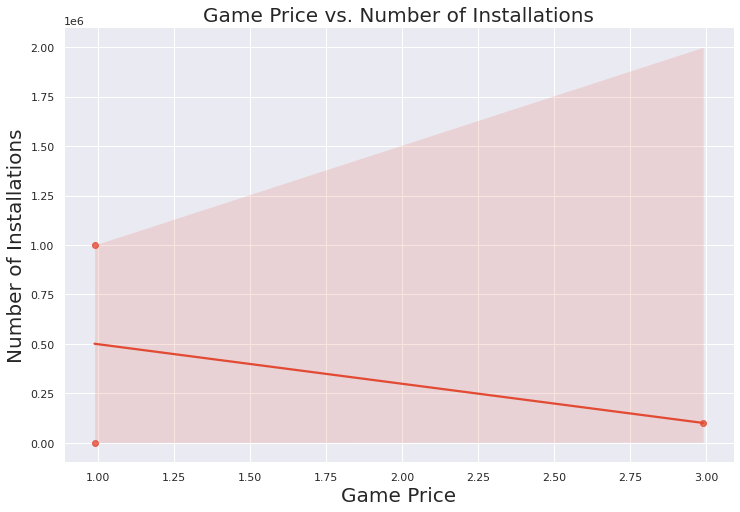

In [ ]:
plt.figure(figsize= (12,8))
sns.regplot(A,B)
plt.title ("Game Price vs. Number of Installations", fontsize = 20)
plt.xlabel ("Game Price",fontsize = 20)
plt.ylabel ( "Number of Installations", fontsize = 20)
plt.show

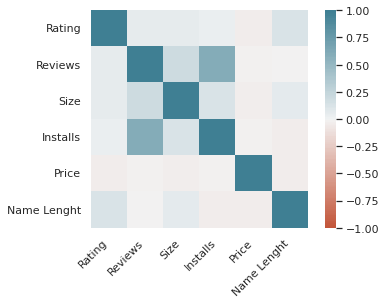

In [ ]:
corr = df.corr()
ax = sns.heatmap(
corr,
vmin=-1, vmax=1, center=0,
cmap=sns.diverging_palette(20, 220, n=200),
square=True
)
ax.set_xticklabels(
ax.get_xticklabels(),
rotation=45,
horizontalalignment='right'
);

In [ ]:
#show correlations
correlation_pair = df.corr()["Price"][:]
print(correlation_pair)

Rating        -0.036110
Reviews       -0.010281
Size          -0.025107
Installs      -0.012453
Price          1.000000
Name Lenght   -0.033065
Name: Price, dtype: float64


In [ ]:
#show strong correlations
strong_pairs = correlation_pair[(abs(correlation_pair) > 0.009)]
print(strong_pairs)

Rating        -0.036110
Reviews       -0.010281
Size          -0.025107
Installs      -0.012453
Price          1.000000
Name Lenght   -0.033065
Name: Price, dtype: float64


In [ ]:
pairs_df = strong_pairs.to_frame()

In [ ]:
pairs_list = pairs_df.index.tolist()
regression_df = df[pairs_list]
regression_df.head()

,Rating,Reviews,Size,Installs,Price,Name Lenght
8968,NaN,2,4.200,500.0,0.0,23
4208,4.5,2,3.000,100.0,0.0,33
384,4.0,122498,0.079,10000000.0,0.0,29
4243,4.3,421000,36.000,10000000.0,0.0,7
179,4.4,233757,NaN,10000000.0,0.0,12


In [ ]:
#wechseln zur aktuellen Datei (test df)
#tree_df = pd.read_csv("https://raw.githubusercontent.com/teegrun/colab/main/googleplaystore.csv")
tree_df = df
tree_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3112 entries, 8968 to 10719
Data columns (total 14 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   App             3112 non-null   object 
 1   Category        3112 non-null   object 
 2   Rating          2657 non-null   float64
 3   Reviews         3112 non-null   int64  
 4   Size            2639 non-null   float64
 5   Installs        3112 non-null   float64
 6   Type            3112 non-null   object 
 7   Price           3112 non-null   float64
 8   Content Rating  3112 non-null   object 
 9   Genres          3112 non-null   object 
 10  Last Updated    3112 non-null   object 
 11  Current Ver     3110 non-null   object 
 12  Android Ver     3111 non-null   object 
 13  Name Lenght     3112 non-null   int64  
dtypes: float64(4), int64(2), object(8)
memory usage: 364.7+ KB


In [ ]:
quantile_list = [0, .25, .5, .75, 1.]
quantiles = tree_df['Price'].quantile(quantile_list)
quantiles

0.00      0.00
0.25      0.00
0.50      0.00
0.75      0.00
1.00    399.99
Name: Price, dtype: float64

In [ ]:
data_rf = df
data_rf.reset_index(drop=True, inplace=True)

In [ ]:
from sklearn.model_selection import train_test_split
x_rf=data_rf[['Price', 'Size', 'Reviews']]
y_rf=data_rf['Installs']
x_rf_train, x_rf_test, y_rf_train, y_rf_test = train_test_split(x_rf, y_rf, test_size=0.3)

In [ ]:
from sklearn.ensemble import RandomForestClassifier

clf=RandomForestClassifier(n_estimators=100)

clf.fit(x_rf_train, y_rf_train)

y_rf_pred=clf.predict(x_rf_test)

from sklearn import metrics

ValueError: ignored